In [21]:
# OPTIONAL: Load the "autoreload" extension so that code can change
%load_ext autoreload

# OPTIONAL: always reload modules so that as you change code in src, it gets loaded
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [22]:
from data.semi_supervised_data import *

In [23]:
from matplotlib import pyplot as plt

In [42]:
parser = pd.Series()
parser = pd.concat([parser, pd.Series({'text_col': "Text Transcription"})])
parser = pd.concat([parser, pd.Series({'batchsize': 64})])
parser = pd.concat([parser, pd.Series({'use_augmentation': True})])

args = parser
args

/tmp/ipykernel_1251073/318514586.py:1: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  parser = pd.Series()


text_col            Text Transcription
batchsize                           64
use_augmentation                  True
dtype: object

In [43]:
train_supervised_loader, train_unsupervised_loader, val_loader, im_transforms, txt_transforms = create_semi_supervised_dataloaders(args,
                                                                                                train_img_dir='../data/MAMI_processed/images/train',
                                                                                                train_labeled_csv='../data/MAMI_processed/train_labeled_ratio-0.3.csv',
                                                                                                train_unlabeled_csv='../data/MAMI_processed/train_unlabeled_ratio-0.3.csv',
                                                                                                val_img_dir = '../data/MAMI_processed/images/val',
                                                                                                val_csv='../data/MAMI_processed/val.csv',
                                                                                                batch_size=args.batchsize, image_size=384, debug=True)


Compute vocabulary for 8000 sentences.
Loaded and processed 2400 Samples in ../data/MAMI_processed/train_labeled_ratio-0.3.csv
Loaded and processed 5600 Samples in ../data/MAMI_processed/train_unlabeled_ratio-0.3.csv
Loaded and processed 2000 Samples in ../data/MAMI_processed/val.csv


In [44]:
# for toks in train_sup.text_transform_outputs['input_ids'][:10]:
#     print(txt_transforms.tokenizer.convert_ids_to_tokens(toks, skip_special_tokens=True))

In [45]:
# train_sup.metadata.iloc[:10]

In [46]:
# train_sup.img_names[:10]

In [47]:
# toks = {key: values[:10] for key, values in train_sup.text_transform_outputs.items()}['input_ids']
# toks

In [48]:
# txt_transforms.tokenizer.convert_ids_to_tokens(toks, skip_special_tokens=True)

In [49]:
(train_sup_img_batch, train_sup_text_batch), train_sup_label_batch = next(iter(train_supervised_loader))

In [50]:
# train_supervised_loader.dataset

In [51]:
# img_batch = train_sup_img_batch
# text_batch = train_sup_text_batch
# label_batch = train_sup_label_batch
# im_transforms = im_transforms
# txt_transforms = txt_transforms

def visual_batch(img_batch, text_batch, label_batch=None, im_transforms=None, txt_transforms=None):
#     print(text_batch)
    
    for i in range(len(img_batch)):
        print(f"Sample: {i}")

        if not label_batch is None:
            label = label_batch[i]
            print(f"Label: {label}")
        
        text = {key: values[i] for key, values in text_batch.items()}
        for key in text.keys():
            if key == 'sentence_vectors':
                sentence_vectors_decode = txt_transforms.sentence_vectors_extractor.inverse_transform(text['sentence_vectors'].unsqueeze(0))
                print(f"Count vector: {sentence_vectors_decode}")
            elif key == 'input_ids':
                sample_toks = txt_transforms.tokenizer.convert_ids_to_tokens(text['input_ids'], skip_special_tokens=True)
                print(f"Bert token: {sample_toks}")

        img = img_batch[i]
        img = torch.permute(img, (1,2,0))
        img = img * torch.tensor(im_transforms.std) + torch.tensor(im_transforms.mean)
        plt.imshow(img)

        plt.show()
        print()

Sample: 0
Label: 1
Count vector: [array(['1h', '38', '57', '66', 'ass', 'blame', 'checking', 'childhood',
       'for', 'friend', 'funny', 'gaming', 'liking', 'my', 'out', 'share',
       'that', 'thicc', 'with', 'women', 'your'], dtype='<U25')]
Bert token: ['7', ':', '38', 'funny', '4', '##h', 'checking', 'out', 'that', 'ass', 'with', 'your', 'friend', '3', '.', '3', '##k', '66', 'gaming', '1', '##h', 'i', 'blame', 'my', 'childhood', 'for', 'liking', 'th', '##ic', '##c', 'women', '0', '57', '%', '-', 'd', 'share']


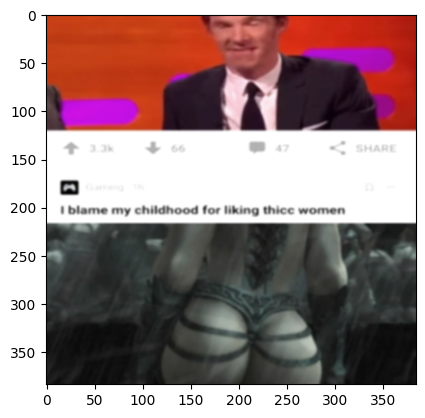


Sample: 1
Label: 0
Count vector: [array(['40', 'and', 'ch', 'focus', 'fucking', 'he', 'is', 'love', 'man',
       'my', 'of', 'oh', 'san', 'sheer', 'thank', 'will', 'yo', 'you'],
      dtype='<U25')]
Bert token: ['oh', ',', 'my', ',', 'thank', 'you', '!', 'ch', ',', 'my', ',', 'thank', 'you', '.', 'ch', ',', 'my', ',', 'thank', 'you', '.', '40', '-', 'ri', '##ko', '-', 'san', ',', 'i', 'love', 'you', '!', '40', '-', 'ri', '##ko', '-', 'san', ',', 'love', 'you', '.', 'yo', '-', 'ri', '##ko', '-', 'san', ',', 'love', 'you', '.', 'h', 'cr', 'he', 'is', 'a', 'man', 'of', 'focus', ',', 'commitment', ',', 'and', 'sheer', 'fucking', 'will']


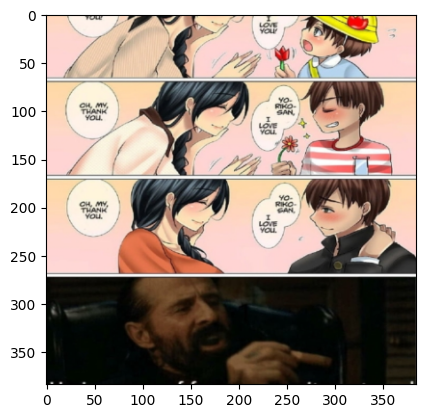


Sample: 2
Label: 1
Count vector: [array(['are', 'for', 'me', 'those', 'to', 'too', 'ugly', 'women'],
      dtype='<U25')]
Bert token: ['those', 'women', 'are', 'too', 'ugly', 'for', 'me', 'to', 'mole', '##st', '.']


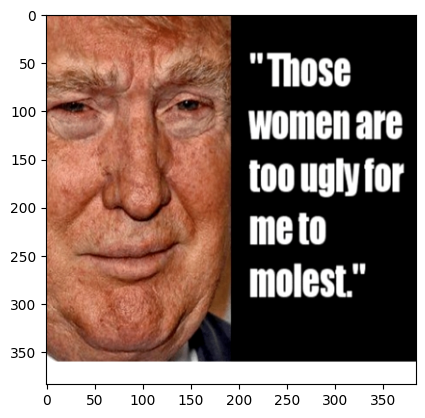


Sample: 3
Label: 0
Count vector: [array(['it', 'killing', 'knowing', 'me', 'the', 'training', 'won'],
      dtype='<U25')]
Bert token: ['me', 'killing', 'the', 'training', 'process', 'knowing', 'it', 'won', "'", 't', 'improve', 'further']


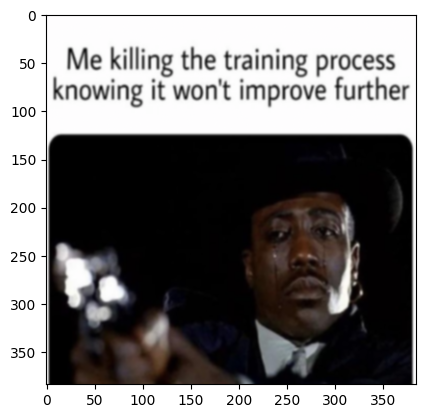


Sample: 4
Label: 0
Count vector: [array(['actually', 'and', 'check', 'clean', 'cleaning', 'done', 'gotta',
       'here', 'if', 'it', 'moms', 'order', 're', 'room', 'say', 'the',
       'when', 'you', 'your'], dtype='<U25')]
Bert token: ['when', 'you', 'say', 'you', "'", 're', 'done', 'cleaning', 'the', 'room', 'and', 'your', 'mom', '##s', 'gotta', 'check', 'if', 'it', "'", 's', 'actually', 'clean', 'galley', 'gr', '##ub', 'order', 'here']


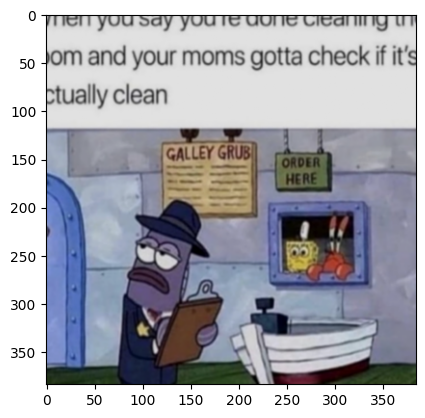


Sample: 5
Label: 0
Count vector: [array(['about', 'at', 'back', 'battle', 'can', 'dinner', 'explaining',
       'good', 'know', 'me', 'my', 'not', 'of', 'our', 'party', 'small',
       'something', 'sure', 'talk', 'the', 'think', 'what', 'wife',
       'with', 'you', 'your'], dtype='<U25')]
Bert token: ['<', 'at', 'our', 'dinner', 'party', '>', 'my', 'wife', ':', '<', 'whispering', ':', 'talk', 'with', 'your', 'guests', '!', 'me', ':', '<', 'whispering', 'back', '>', 'about', 'what', '?', 'you', 'know', 'i', "'", 'm', 'not', 'good', 'with', 'small', 'talk', '!', 'my', 'wife', ':', '<', 'whispering', '>', 'i', "'", 'm', 'sure', 'you', 'can', 'think', 'of', 'something', '!', 'me', ':', '<', 'explaining', 'the', 'battle', 'of', 'stalin', '##grad', '>', '178', 'fx']


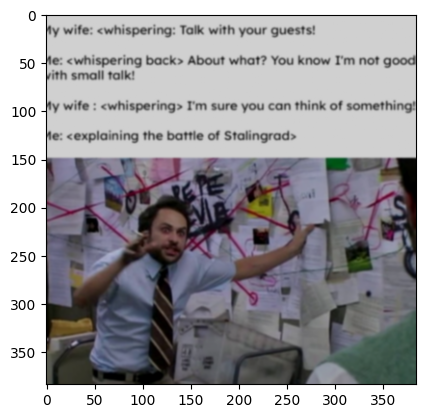


Sample: 6
Label: 0
Count vector: [array(['also', 'dat', 'evil', 'guy', 'he', 'man', 'over', 'pure', 'see',
       'sexist', 'trump', 'witch', 'you'], dtype='<U25')]
Bert token: ['cnn', 'fl', 'f', 'cnn', 'you', 'he', '##i', 'man', ',', 'you', 'see', 'dat', 'guy', 'over', 'der', '##e', '?', 'fa', 'he', "'", 's', 'a', 'trump', 'su', '##pp', '##rt', '##r', ',', 'witch', 'me', '##en', '##z', 'he', 'i', '##z', 'also', 'a', 'ra', '##cis', '##ss', ',', 'nazi', ',', 'homo', '##fo', '##b', ',', 'fascist', ',', 'mis', '##og', '##ins', '##t', ',', 'sex', '##ist', ',', 'k', '##kk', ',', 'red', '##ne', '##k', ',', 'wit', '##e', 'su', '##pre', '##mic', '##ist', ',', 'n', 'pure', 'evil']


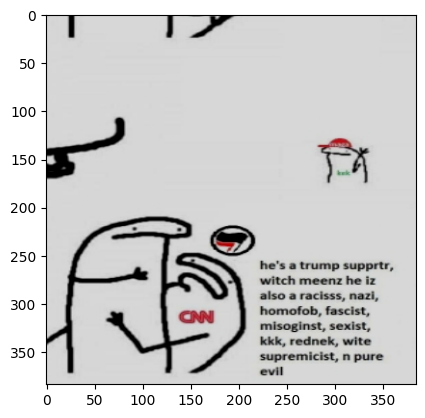


Sample: 7
Label: 0
Count vector: [array(['bar', 'don', 'friend', 'got', 'him', 'house', 'kitchen', 'know',
       'last', 'mad', 'mothers', 'my', 'night', 'told', 'was', 'when',
       'where', 'why', 'your'], dtype='<U25')]
Bert token: ['i', 'don', "'", 't', 'know', 'why', 'my', 'friend', 'got', 'mad', 'your', 'mothers', 'house', 'kitchen', '&', 'bar', 'when', 'i', 'told', 'him', 'where', 'i', 'was', 'last', 'night']


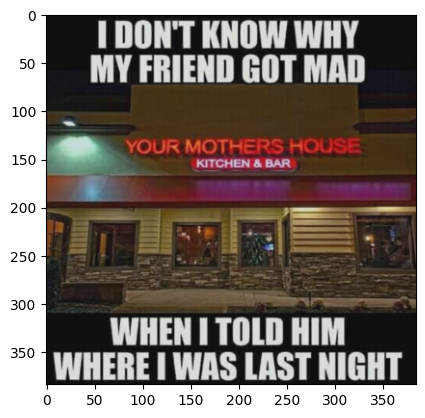


Sample: 8
Label: 1
Count vector: [array(['and', 'answer', 'aren', 'asking', 'beer', 'com', 'if', 'motifake',
       'questions', 're', 'the', 'then', 'women', 'wrong', 'you'],
      dtype='<U25')]
Bert token: ['p', '.', 'h', '.', 'i', '.', 'l', '.', 'o', '.', 's', '.', 'o', '.', 'p', '.', 'h', '.', 'y', '"', 'if', 'beer', 'and', 'women', 'aren', "'", 't', 'the', 'answer', ',', 'then', 'you', "'", 're', 'asking', 'the', 'wrong', 'questions', '.', '"', '(', 'anonymous', ')', 'motif', '##ake', '.', 'com']


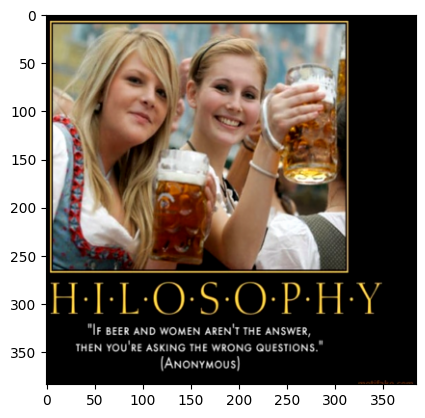


Sample: 9
Label: 1
Count vector: [array(['about', 'after', 'against', 'black', 'but', 'com', 'eye', 'gave',
       'good', 'her', 'look', 'not', 'quickmeme', 'ra', 'she', 'violence',
       'women', 'would'], dtype='<U25')]
Bert token: ['i', "'", 'm', 'not', 'about', 'violence', 'against', 'women', 'but', 'she', 'would', 'look', 'good', 'after', 'i', 'gave', 'her', 'a', 'black', 'eye', 'ra', 'quick', '##me', '##me', '.', 'com']


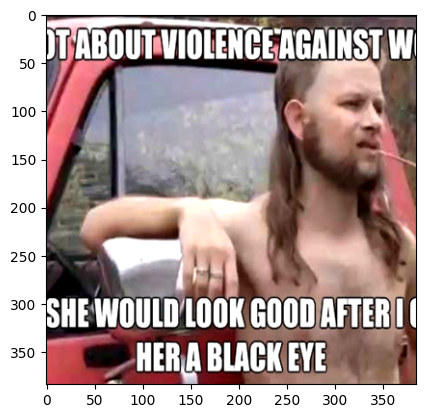


Sample: 10
Label: 1
Count vector: [array(['damn', 'full', 'girl', 're', 'think', 'you'], dtype='<U25')]
Bert token: ['1', 'mode', '##ration', 'damn', ',', 'girl', '.', 'i', 'think', 'you', "'", 're', 'full', '.']


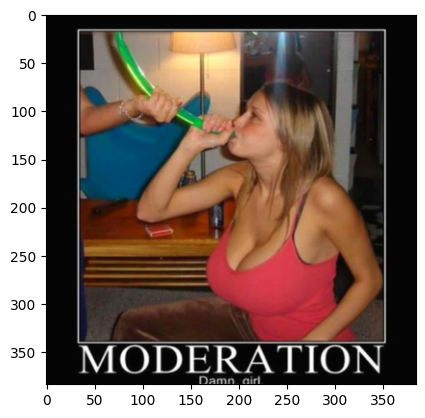


Sample: 11
Label: 0
Count vector: [array(['friends', 'going', 'house', 'my', 'police', 'to'], dtype='<U25')]
Bert token: ['a', '…', 'going', 'to', 'my', 'friends', 'house', 'police', '(', '"', 'le', '##r']


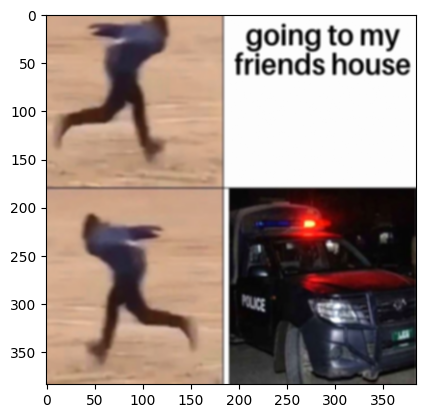


Sample: 12
Label: 1
Count vector: [array(['an', 'but', 'costs', 'have', 'man', 'most', 'nothing', 'of',
       'seem', 'something', 'that', 'the', 'to'], dtype='<U25')]
Bert token: ['manners', 'something', 'that', 'costs', 'nothing', ',', 'but', 'most', 'of', 'the', 'population', 'seem', 'to', 'have', 'an', 'ave', '##rs', '##ion', 'to', '.', 'manners', 'man', 'fe', '##men', '##ists', ':']


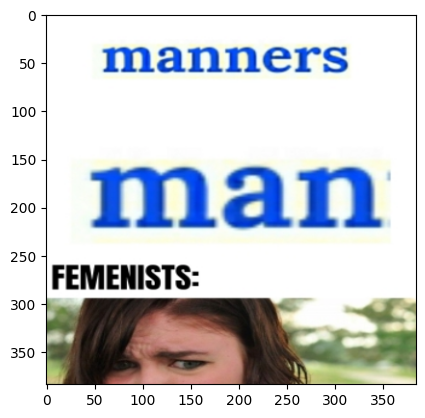


Sample: 13
Label: 1
Count vector: [array(['at', 'birth', 'twins'], dtype='<U25')]
Bert token: ['twins', 'separated', 'at', 'birth', '?']


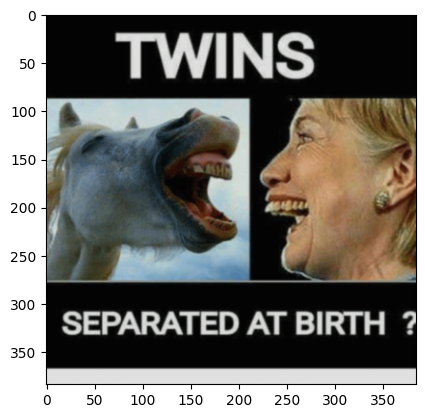


Sample: 14
Label: 1
Count vector: [array(['com', 'imgflip', 'tail', 'whale'], dtype='<U25')]
Bert token: ['alaska', '##n', 'whale', 'tail', 'wisconsin', 'whale', 'tail', 'im', '##gf', '##lip', '.', 'com']


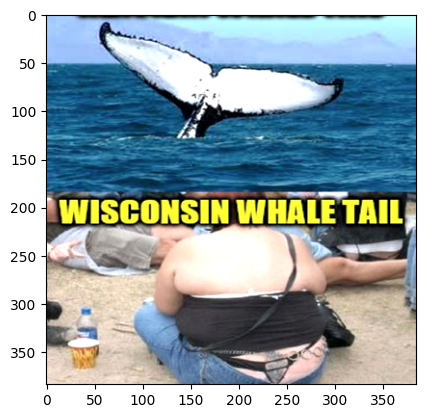


Sample: 15
Label: 0
Count vector: [array(['and', 'at', 'gordon', 'his', 'in', 'ramsay', 'restaurant', 'see',
       'walk', 'when', 'with', 'work', 'you'], dtype='<U25')]
Bert token: ['when', 'you', 'work', 'at', 'a', 'restaurant', 'and', 'see', 'gordon', 'ramsay', 'walk', 'in', 'with', 'his', 'camera', 'crew']


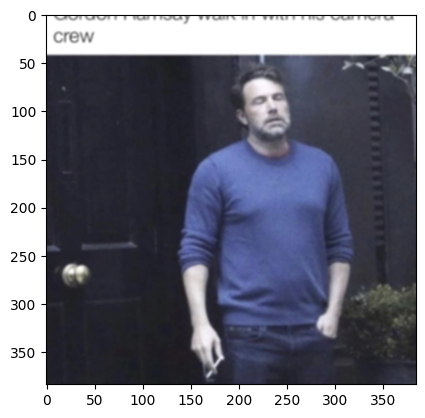


Sample: 16
Label: 1
Count vector: [array(['and', 'face', 'her', 'hits', 'hole', 'in', 'it', 'makes', 'net',
       'she', 'slips', 'teeth', 'the', 'when', 'wisdom', 'wrong'],
      dtype='<U25')]
Bert token: ['the', 'face', 'she', '-', 'makes', 'when', 'it', 'slips', 'in', 'the', 'wrong', 'hole', 'and', 'hits', 'her', 'wisdom', 'teeth', '!', '!', '!', 'e', '##gen', '##era', '##tor', '.', 'net']


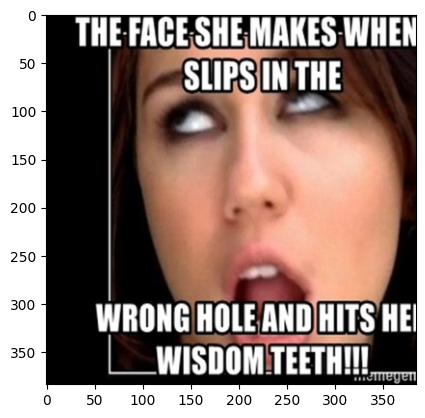


Sample: 17
Label: 1
Count vector: [array(['after', 'before', 'disney', 'feminism'], dtype='<U25')]
Bert token: ['before', 'disney', "'", 's', 'feminism', '230', '##00', 'after', 'disney', "'", 's', 'feminism']


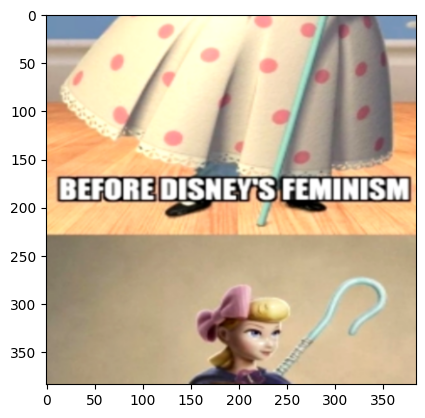


Sample: 18
Label: 0
Count vector: [array(['animal', 'any', 'back', 'boy', 'cut', 'expect', 'from', 'girl',
       'ho', 'is', 'log', 'meat', 'met', 'of', 'raw', 'select', 'set',
       'the', 'would'], dtype='<U25')]
Bert token: ['girl', "'", 's', 'pockets', 'boy', "'", 's', 'pockets', 'adventure', 'log', 'inventory', 'sy', 'raw', 'go', '##ur', '##met', 'meat', 'the', 'pr', '##zed', 'cut', 'of', 'meat', 'is', 'mu', '##sl', '##y', 'from', 'a', 'animal', 'any', 'con', '##nos', '##se', '##ur', 'would', 'ark', 'tender', 'y', 'cut', 'of', 'met', '"', 'go', '##ume', '##t', 'expect', 'set', 'o', 'ho', 'back', 'select', 'o', '$', '5', '.', '57', '##9', 'r']


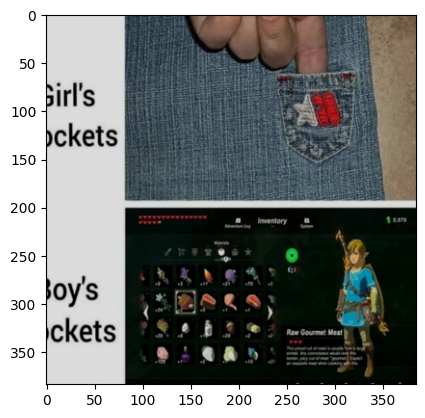

In [52]:
visual_batch(train_sup_img_batch, train_sup_text_batch, train_sup_label_batch, im_transforms=im_transforms, txt_transforms=txt_transforms)

In [36]:
(train_unsup_img_batch, train_unsup_text_batch) = next(iter(train_unsupervised_loader))

Sample: 0
Count vector: [array(['answer', 'award', 'chair', 'creating', 'design', 'down', 'end',
       'for', 'her', 'how', 'manspreading', 'men', 'my', 'national', 'of',
       'ok', 'on', 'public', 'sit', 'space', 'student', 'that', 'the',
       'they', 'this', 'to', 'up', 'wins', 'with', 'women'], dtype='<U25')]
Bert token: ['the', 'end', 'of', 'mans', '##pre', '##ading', '?', 'student', 'fed', 'up', 'with', "'", 'men', 'in', '##fr', '##inging', 'on', 'her', 'public', 'space', "'", 'wins', 'national', 'design', 'award', 'for', 'creating', 'chair', 'that', 'restrict', '##s', 'how', 'they', 'sit', 'down', 'www', '##v', 'women', "'", 's', 'chair', 'women', "'", 's', 'chair', 'my', 'answer', 'to', 'this', 'shi', '##iii', '##t', '!', '!', '!', '!', '!', '!', 'men', "'", 's', 'chair', 'ok', 'men', "'", 's', 'chair']


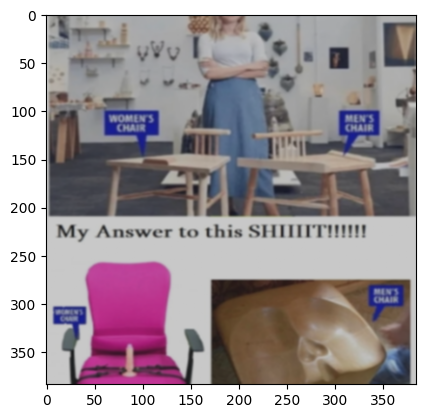


Sample: 1
Count vector: [array(['at', 'day', 'during', 'night', 'programmers', 'the'], dtype='<U25')]
Bert token: ['programmers', ':', 'during', 'the', 'day', 'at', 'night']


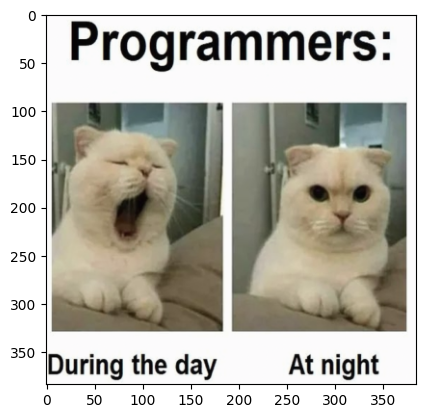


Sample: 2
Count vector: [array(['draw', 'her', 'let', 'or', 'own', 'should', 'tell'], dtype='<U25')]
Bert token: ['should', 'i', 'tell', 'her', '?', 'or', 'should', 'i', 'let', 'her', 'draw', 'her', 'own', 'conclusions', '?']


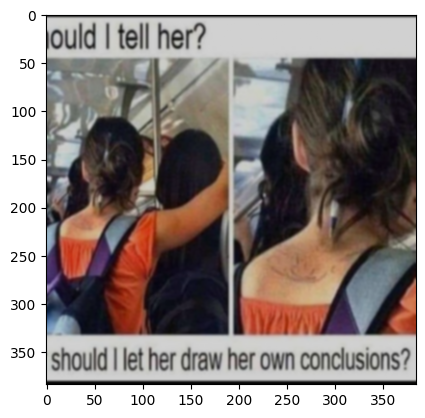


Sample: 3
Count vector: [array(['bite', 'chicken', 'com', 'eat', 'in', 'is', 'it', 'piece',
       'small', 'so', 'would'], dtype='<U25')]
Bert token: ['chicken', 'piece', 'in', 'bi', '##rya', '##ni', 'is', 'so', 'small', 'me', '##mer', '##ot', '##i', '.', 'com', 'i', 'would', 'accident', '##ly', 'eat', 'it', 'in', '1', 'bite']


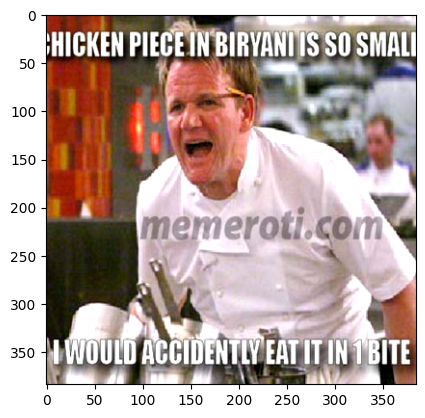


Sample: 4
Count vector: [array(['about', 'com', 'like', 'me', 'quickmeme', 'says', 'she',
       'someone', 'talking', 'was', 'you'], dtype='<U25')]
Bert token: ['adele', 'says', 'someone', 'like', 'you', 'she', 'was', 'talking', 'about', 'me', 'quick', '##me', '##me', '.', 'com']


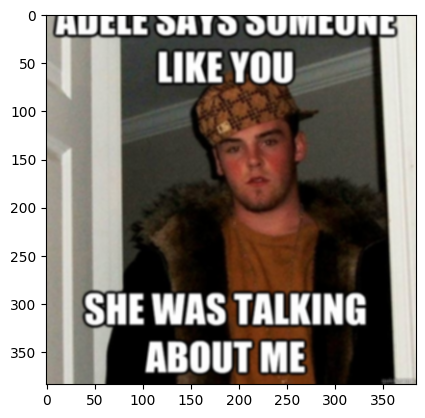


Sample: 5
Count vector: [array(['com', 'iron', 'man', 'woman', 'www'], dtype='<U25')]
Bert token: ['iron', 'man', 'offensive', '##hum', '##our', '.', 'com', 'iron', 'woman', 'www']


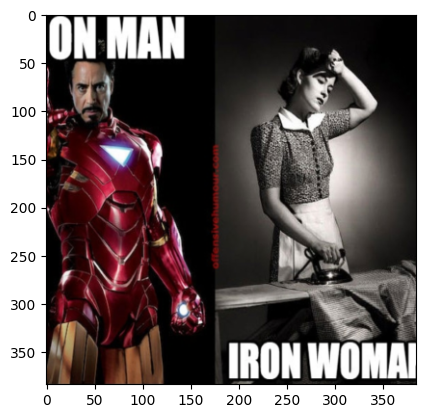


Sample: 6
Count vector: [array(['24', 'enjoy', 'from', 'housewife', 'how', 'im', 'like', 'old',
       'really', 'remove', 'tips', 'watching', 'worker', 'year', 'you'],
      dtype='<U25')]
Bert token: ['i', 'really', 'enjoy', 'watching', 'house', '##wife', 'tips', ',', 'like', 'how', 'you', 'remove', 'stains', 'from', 'clothing', 'im', 'a', '24', 'year', 'old', 'over', '##weight', 'construction', 'worker']


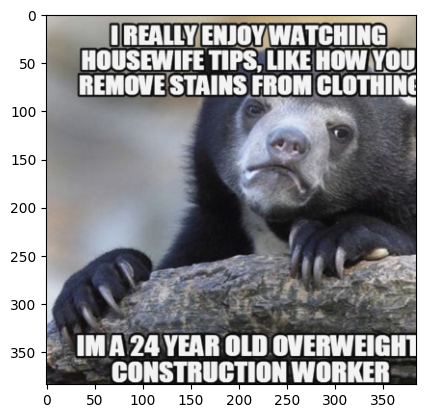


Sample: 7
Count vector: [array(['about', 'pic', 'politics', 'post', 'something', 'with', 'women'],
      dtype='<U25')]
Bert token: ['post', 'something', 'about', 'politics', 'post', 'women', 'pic', 'with', 'thong', '##s']


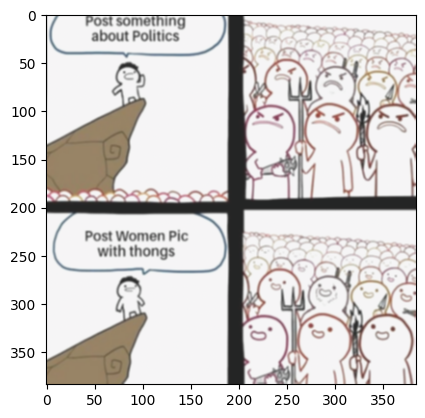


Sample: 8
Count vector: [array(['actually', 'asked', 'boy', 'business', 'call', 'can', 'could',
       'didn', 'doing', 'don', 'expect', 'feel', 'for', 'forced', 'from',
       'full', 'get', 'going', 'have', 'having', 'her', 'how', 'in',
       'just', 'karen', 'know', 'me', 'mom', 'mum', 'on', 'out', 'please',
       're', 'ready', 'shower', 'sorry', 'step', 'teach', 'the', 'to',
       'want', 'what', 'woman', 'you', 'your'], dtype='<U25')]
Bert token: ['having', 'a', 'step', 'mom', ',', 'what', 'you', 'want', 'to', 'get', 'i', "'", 'm', 'going', 'to', 'teach', 'you', 'how', 'to', 'please', 'a', 'woman', '!', 'what', 'you', 'expect', 'from', 'her', 'naughty', 'boy', ',', 'peeking', 'on', 'me', 'in', 'the', 'shower', '!', 'you', 'could', 'have', 'just', 'asked', 'for', 'a', 'full', 'preview', '!', 'w', 'what', 'you', 'actually', 'get', 'don', "'", 't', 'feel', 'forced', 'to', 'call', 'me', 'mum', ',', 'you', 'can', 'call', 'me', 'karen', '!', 'what', 'you', 'actually', 'get', 'sorry

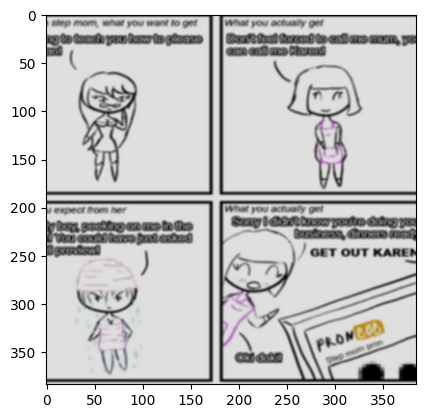


Sample: 9
Count vector: [array(['and', 'are', 'but', 'by', 'cant', 'course', 'feminist', 'guy',
       'just', 'killed', 'males', 'of', 'other', 'raped', 'right', 'too',
       'woman', 'you'], dtype='<U25')]
Bert token: ['guy', ':', 'feminist', ':', 'guy', ':', 'males', 'are', 'killed', 'and', 'raped', 'too', '!', 'of', 'course', ',', 'but', 'by', 'other', 'males', 'you', 'are', 'right', '.', '.', '.', 'a', 'woman', 'just', 'can', '##t', '.', '.', '.', 'dat', '##hi']


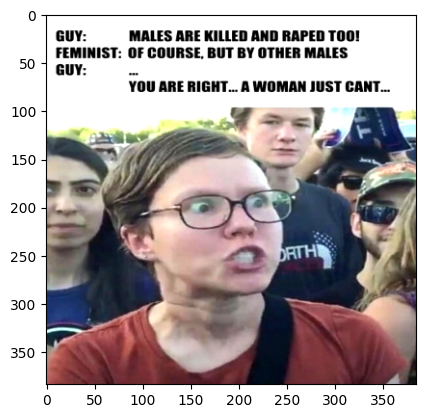


Sample: 10
Count vector: [array(['and', 'com', 'dead', 'for', 'forcing', 'girl', 'guy', 'here',
       'him', 'his', 'in', 'me', 'mother', 'steve', 'to', 'touched',
       'tree', 've', 'watch', 'www'], dtype='<U25')]
Bert token: ['i', "'", 'm', 'in', 'here', 'for', 'kidnapping', 'a', 'guy', ',', 'tying', 'him', 'to', 'a', 'tree', 'and', 'forcing', 'him', 'to', 'watch', 'me', 'dig', 'lip', 'and', 'violate', 'his', 'dead', 'mother', "'", 's', 'corpse', '.', '02', '##00', '##9', 'steve', 'napier', '##ski', 'i', "'", 've', 'touched', 'a', 'girl', '.', 'www', '.', 'duel', '##inga', '##nal', '##og', '##s', '.', 'com']


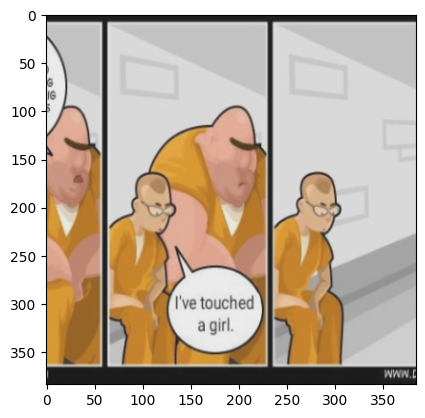


Sample: 11
Count vector: [array(['49', 'can', 'duct', 'if', 'its', 'no', 'not', 'rape', 'say',
       'tape', 'you'], dtype='<U25')]
Bert token: ['49', 'duct', 'tape', 'its', 'not', 'rape', 'if', 'you', 'can', "'", 't', 'say', 'no', '.']


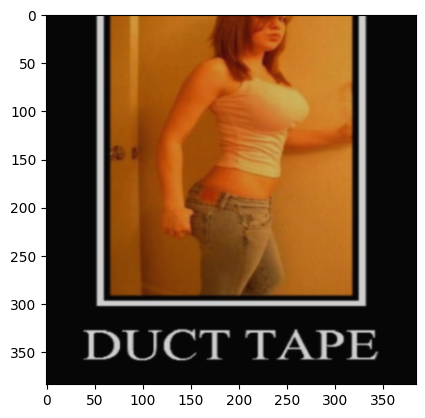


Sample: 12
Count vector: [array(['cher', 'de', 'hunt', 'milf', 'the'], dtype='<U25')]
Bert token: ['the', 'cher', 'hunt', 'ni', '##lf', '##gaard', 'mil', '##f', 'guard', 'de']


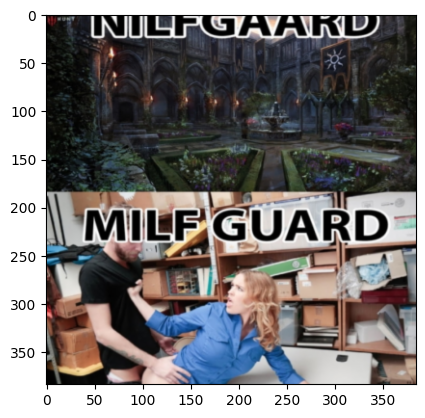


Sample: 13
Count vector: [array(['2000', 'changed', 'have', 'how', 'over', 'the', 'women', 'years'],
      dtype='<U25')]
Bert token: ['how', 'women', 'have', 'changed', 'over', 'the', 'years', 'aaa', '##a', '1970', "'", 's', '1980', "'", 's', '1990', "'", 's', '2000', "'", 's']


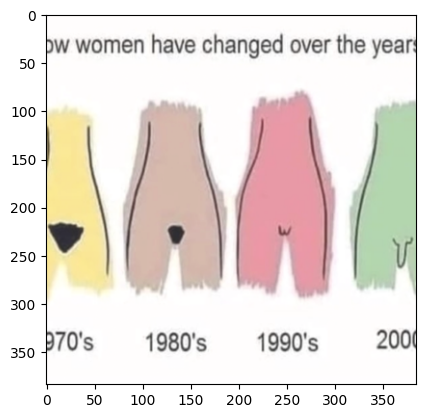


Sample: 14
Count vector: [array(['fuck', 'her', 'in', 'pussy', 'right', 'the'], dtype='<U25')]
Bert token: ['fuck', 'her', 'right', 'in', 'the', 'pussy', '!']


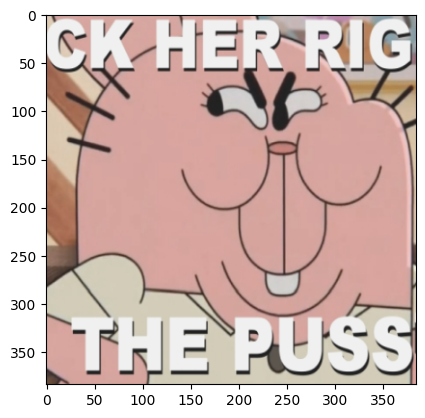


Sample: 15
Count vector: [array(['after', 'and', 'around', 'ass', 'because', 'coming', 'get', 'if',
       'is', 'just', 'leave', 'question', 'sex', 'she', 'starts',
       'stupid', 'up', 'your'], dtype='<U25')]
Bert token: ['if', 'she', 'starts', 'drawing', 'shapes', 'around', 'your', 'ni', '##ps', 'after', 'sex', ',', 'just', 'get', 'up', 'and', 'leave', 'because', 'a', 'stupid', 'ass', 'question', 'is', 'coming', '.']


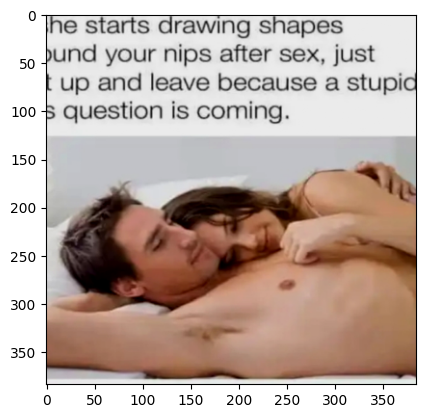


Sample: 16
Count vector: [array(['barbie', 'bestdemotivationalposters', 'com', 'fantastic', 'girl',
       'in', 'it', 'life', 'plastic', 'world'], dtype='<U25')]
Bert token: ['best', '##de', '##mot', '##ivation', '##al', '##post', '##ers', '.', 'com', 'i', "'", 'm', 'a', 'barbie', 'girl', 'in', 'a', 'barbie', 'world', ',', 'life', 'in', 'plastic', ',', 'it', "'", 's', 'fantastic']


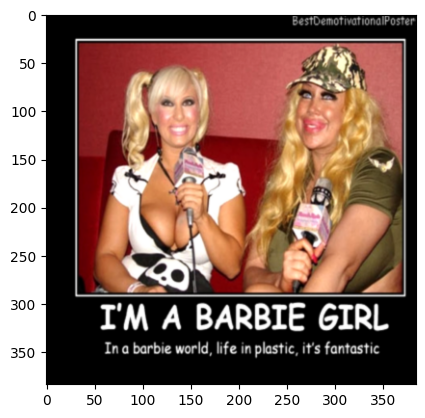


Sample: 17
Count vector: [array(['com', 'don', 'during', 'imgflip', 'is', 'makeup', 'quarantine',
       'something', 'the', 'to', 'view', 'want', 'without'], dtype='<U25')]
Bert token: ['joy', 'be', '##har', 'without', 'makeup', 'during', 'the', 'qu', '##aran', '##tine', 'is', 'something', 'i', 'don', "'", 't', 'want', 'to', 'view', 'im', '##gf', '##lip', '.', 'com']


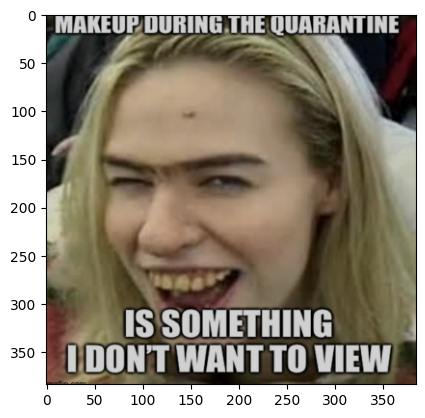


Sample: 18
Count vector: [array(['drivers', 'even', 'lol', 'scare', 'themselves', 'they', 'women'],
      dtype='<U25')]
Bert token: ['jan', 'women', 'drivers', 'they', 'even', 'scare', 'themselves', 'lo', '##l', '-', 'kitty', '##kat']


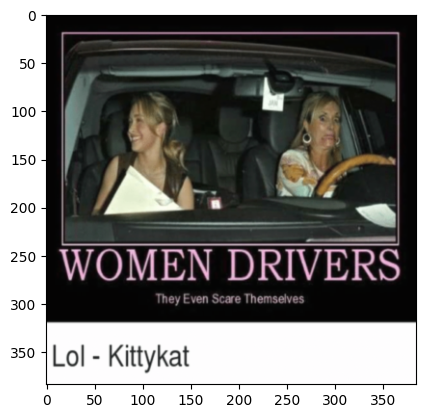


Sample: 19
Count vector: [array(['an', 'baking', 'dicks', 'for', 'just', 'look', 'soda', 'sucked',
       'that', 'when', 'you'], dtype='<U25')]
Bert token: ['that', 'look', 'when', 'you', 'just', 'sucked', '3', 'dick', '##s', '@', 'fk', '##nb', '##ang', 'for', 'an', '8', 'ball', '##of', 'baking', 'soda']


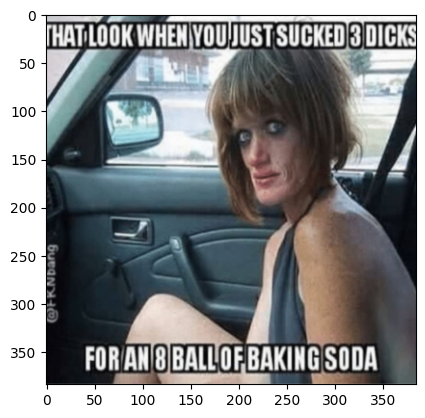


Sample: 20
Count vector: [array(['are', 'because', 'com', 'hard', 'if', 'its', 'mate', 'memeful',
       'no', 'strong', 'them', 'there', 'to', 'what', 'with', 'women'],
      dtype='<U25')]
Bert token: ['what', 'if', 'there', 'are', 'no', 'strong', 'women', 'r', 'because', 'its', 'hard', 'to', 'mate', 'with', 'them', '?', 'me', '##me', '##ful', '.', 'com']


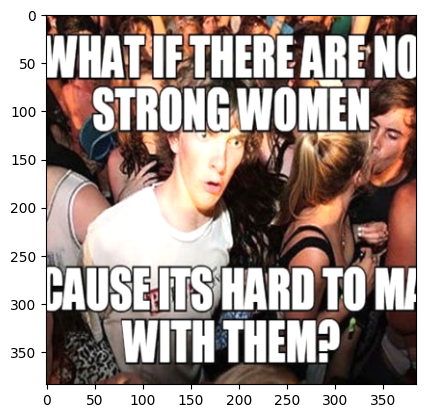


Sample: 21
Count vector: [array(['lying', 'misogynist', 'one', 'pop', 'who'], dtype='<U25')]
Bert token: ['pop', 'corn', 'mis', '##ogy', '##nist', ':', 'one', 'who', 'demonstrates', 'anita', 'sar', '##kee', '##sian', 'lying']


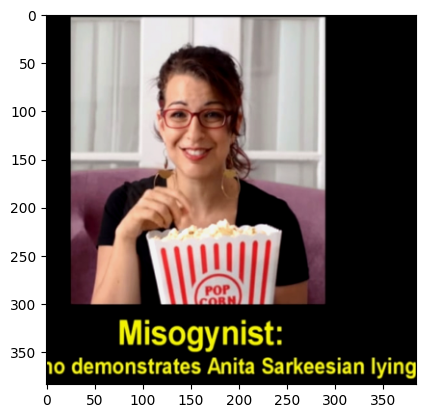


Sample: 22
Count vector: [array(['about', 'and', 'ass', 'clean', 'eat', 'else', 'food', 'know',
       'mexican', 're', 'somebody', 'to', 'when', 'will', 'you', 'your'],
      dtype='<U25')]
Bert token: ['when', 'you', "'", 're', 'about', 'to', 'eat', 'mexican', 'food', 'and', 'you', 'know', 'somebody', 'else', 'will', 'clean', 'your', 'ass']


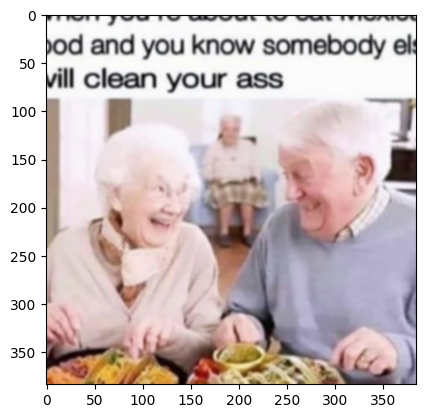


Sample: 23
Count vector: [array(['accepted', 'be', 'can', 'challenge', 'choose', 'coffee', 'get',
       'hard', 'it', 'll', 'me', 'my', 'ok', 'something', 'stupid',
       'table', 'to', 'wife', 'you'], dtype='<U25')]
Bert token: ['my', 'wife', ':', 'ok', ',', 'you', 'can', 'choose', 'a', 'coffee', 'table', '.', 'it', "'", 'll', 'be', 'hard', 'to', 'get', 'something', 'stupid', '.', 'me', ':', 'challenge', 'accepted']


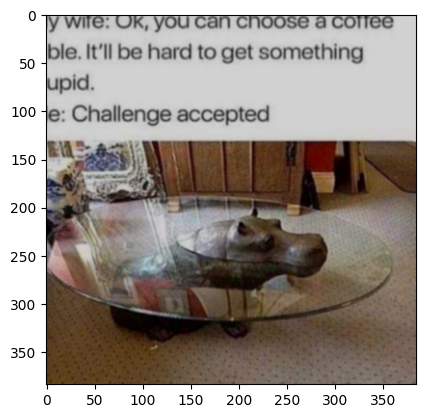


Sample: 24
Count vector: [array(['body', 'for', 'had', 'hot', 'in', 'mind', 'not', 'smoking', 'was',
       'what', 'when'], dtype='<U25')]
Bert token: ['when', 'las', '##ked', 'for', 'a', 'smoking', 'hot', 'body', ',', 'men', '##opa', '##use', 'was', 'not', 'what', 'i', 'had', 'in', 'mind', '.']


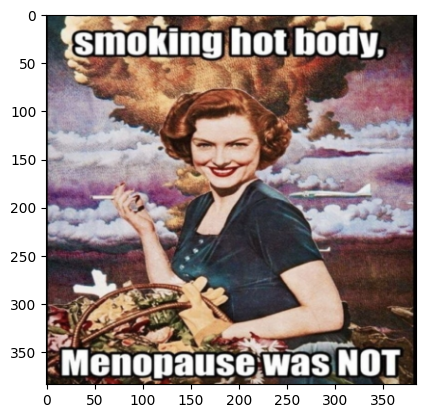


Sample: 25
Count vector: [array(['balance', 'brings', 'good', 'life', 'man', 'to', 'wife'],
      dtype='<U25')]
Bert token: ['a', 'good', 'wife', 'brings', 'balance', 'to', 'a', 'man', "'", 's', 'life']


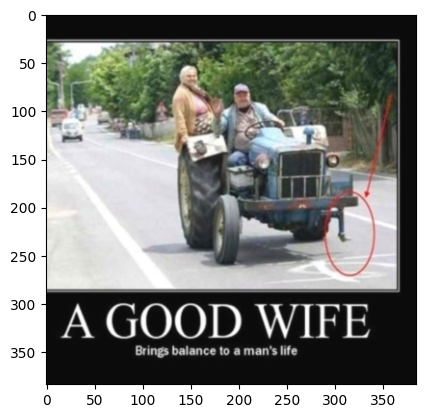


Sample: 26
Count vector: [array(['dr', 'without'], dtype='<U25')]
Bert token: ['dr', '.', 'stone', 'without', 'context']


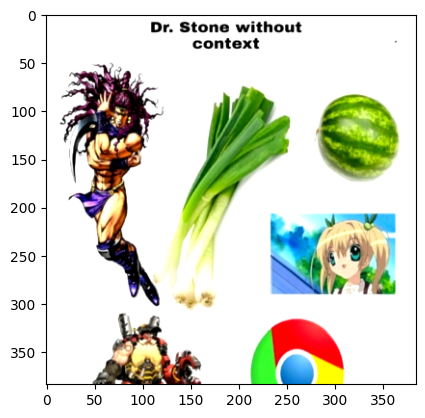


Sample: 27
Count vector: [array(['but', 'clean', 'for', 'have', 'just', 'like', 'mo', 'motivation',
       'need', 'no', 'sit', 'so', 'there', 'to', 'when', 'while', 'you'],
      dtype='<U25')]
Bert token: ['when', 'you', 'need', 'to', 'clean', 'but', 'have', 'no', 'motivation', 'like', 'so', 'you', 'just', 'sit', 'there', 'for', 'a', 'while', 'mo']


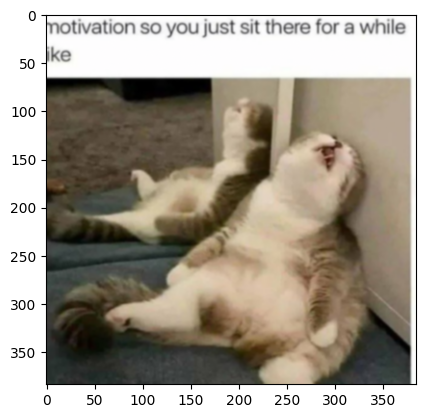

In [37]:
visual_batch(train_unsup_img_batch, train_unsup_text_batch, im_transforms=im_transforms, txt_transforms=txt_transforms)

In [38]:
(val_sup_img_batch, val_sup_text_batch), val_sup_label_batch = next(iter(val_loader))

Sample: 0
Label: 0
Count vector: [array(['at', 'but', 'friend', 'goes', 'he', 'house', 'it', 'shit', 'take',
       'the', 'to', 'toilet', 'when', 'won', 'you', 'your'], dtype='<U25')]
Bert token: ['when', 'you', 'take', 'a', 'shit', 'at', 'the', 'friend', "'", 's', 'house', ',', 'but', 'it', 'won', "'", 't', 'flush', 'your', 'friend', 'when', 'he', 'goes', 'to', 'the', 'toilet']


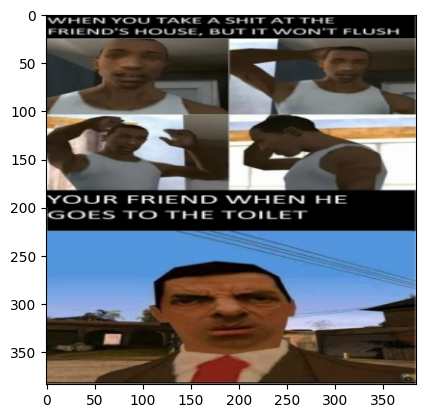


Sample: 1
Label: 1
Count vector: [array(['as', 'at', 'black', 'com', 'eye', 'gave', 'good', 'had', 'her',
       'imgflip', 'listening', 'my', 'not', 'noticed', 'obviously',
       'order', 'she', 'slowly', 'so', 'very'], dtype='<U25')]
Bert token: ['noticed', 'my', 'waitress', 'had', 'a', 'black', 'eye', 'so', 'i', 'gave', 'her', 'my', 'order', 'very', 'slowly', 'as', 'she', "'", 's', 'obviously', 'not', 'good', 'at', 'listening', 'im', '##gf', '##lip', '.', 'com']


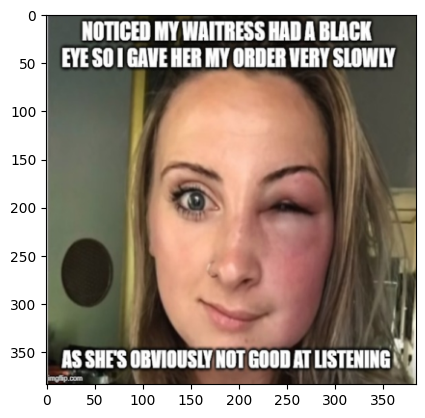


Sample: 2
Label: 0
Count vector: [array(['actually', 'afford', 'an', 'are', 'can', 'crash', 'didnt',
       'entitled', 'for', 'home', 'house', 'idea', 'image', 'it',
       'market', 'my', 'not', 'of', 'on', 'or', 'own', 'seems', 'so',
       'that', 'the', 'their', 'there', 'these', 'they', 'think', 'to',
       'twitter', 'very', 'way', 'what', 'whether', 'why', 'work'],
      dtype='<U25')]
Bert token: ['these', 'entitled', 'millennia', '##ls', 'are', 'cheering', 'for', 'a', 'housing', 'market', 'crash', 'millennia', '##ls', 'are', 'actually', 'cheering', 'for', 'a', 'housing', 'market', 'crash', 'on', 'twitter', 'so', 'they', 'can', 'afford', 'a', 'home', '.', 'it', 'seems', 'the', 'very', 'image', 'of', 'en', '##ti', '##tlement', '.', 'w', '.', 'e', '.', 'mess', '##amo', '##re', '@', 'the', '##hul', '##i', 'a', '##€', '##¢', 'there', "'", 's', 'a', 'way', 'for', 'millennia', '##ls', 'to', 'afford', 'a', 'house', 'of', 'their', 'own', 'whether', 'there', "'", 's', 'a', 'housing',

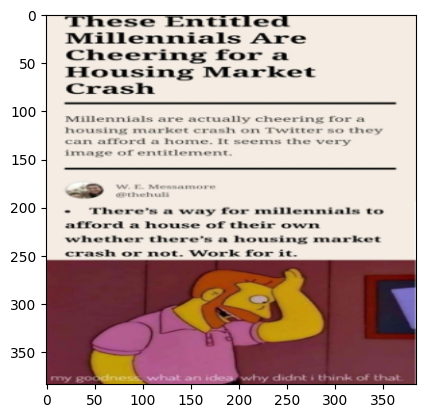


Sample: 3
Label: 1
Count vector: [array(['bad', 'blind', 'date', 'luck'], dtype='<U25')]
Bert token: ['ara', '##nged', 'blind', 'prom', 'date', 'bad', 'luck', 'brian', '.']


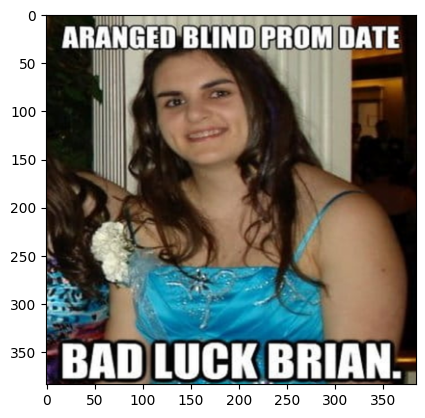


Sample: 4
Label: 0
Count vector: [array(['all', 'an', 'and', 'apple', 'can', 'chocolate', 'completely',
       'could', 'dad', 'didn', 'eat', 'eating', 'empty', 'enjoy',
       'ffffff', 'fffuu', 'from', 'get', 'has', 'have', 'hungry', 'in',
       'into', 'is', 'kitchen', 'later', 'living', 'made', 'me', 'my',
       'now', 'of', 'oh', 'please', 'return', 'room', 'seconds', 'see',
       'seeing', 'sure', 'take', 'that', 'the', 'think', 'this', 'to',
       'tv', 'uuuu', 'want', 'watching', 'why', 'you'], dtype='<U25')]
Bert token: ['dad', 'and', 'i', 'watching', 'tv', 'in', 'living', 'room', 'i', 'didn', "'", 't', 'think', 'you', "'", 'd', 'want', 'all', 'of', 'this', 'chocolate', 'now', 'that', 'you', 'have', 'a', 'nut', '##rit', '##ious', 'i', 'return', 'to', 'see', 'my', 'chocolate', 'bowl', 'is', 'now', 'completely', 'empty', '.', 'apple', 'to', 'enjoy', '.', 'my', 'bowl', 'of', 'chocolate', 'oh', ',', 'and', 'can', 'you', 'take', 'this', 'empty', 'bowl', 'into', 'the', 'kitchen

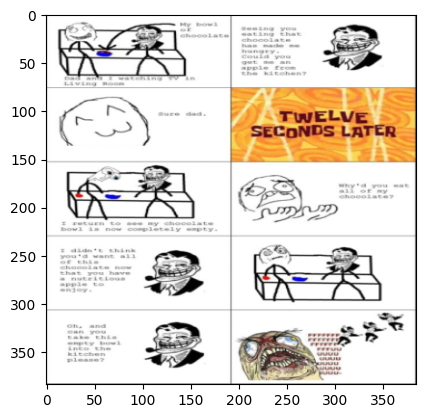


Sample: 5
Label: 0
Count vector: [array(['as', 'but', 'can', 'don', 'hello', 'here', 'in', 'is', 'kinda',
       'let', 'like', 'made', 'my', 'name', 'of', 'see', 'that', 'the',
       'you'], dtype='<U25')]
Bert token: ['hello', ',', 'my', 'name', 'is', 'ko', '##rg', '.', 'i', "'", 'm', 'kinda', 'like', 'the', 'leader', 'in', 'here', '.', 'i', "'", 'm', 'made', 'of', 'rocks', ',', 'as', 'you', 'can', 'see', ',', 'but', 'don', "'", 't', 'let', 'that', 'int', '##imi', '##date', 'you', 'po', '##vr', '##ch', 'sat', '##ent', '##ry', 'x', '##3', 'hm']


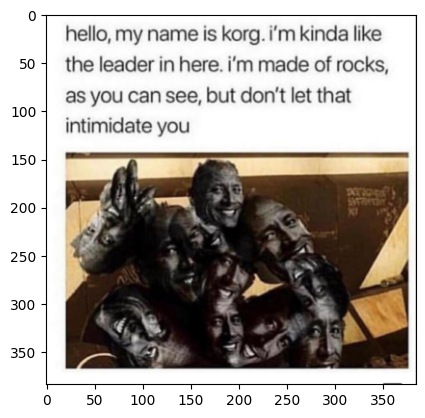


Sample: 6
Label: 0
Count vector: [array(['about', 'believe', 'bet', 'even', 'everyone', 'he', 'her', 'him',
       'his', 'if', 'just', 'lying', 'nose', 'other', 'people', 'tells',
       'that', 'the', 'thinking', 'though', 'told', 'truth', 'was',
       'when', 'women', 'would'], dtype='<U25')]
Bert token: ['her', ':', 'i', 'bet', 'he', "'", 's', 'thinking', 'about', 'other', 'women', '.', 'him', ':', 'if', 'pin', '##oc', '##chio', 'just', 'told', 'people', 'that', 'his', 'nose', 'grows', 'when', 'he', 'tells', 'the', 'truth', ',', 'everyone', 'would', 'believe', 'him', ',', 'even', 'though', 'he', 'was', 'lying']


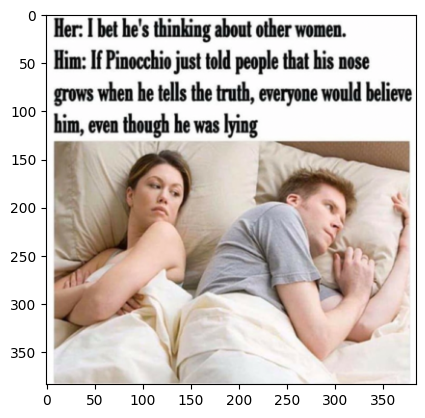


Sample: 7
Label: 1
Count vector: [array(['jobs', 'memegenerator', 'men', 'net', 'not', 'wa', 'woman',
       'work'], dtype='<U25')]
Bert token: ['men', 'work', 'manly', 'jobs', 'wa', 'not', 'a', 'woman', "'", 's', 'me', '##me', '##gen', '##era', '##tor', '.', 'net']


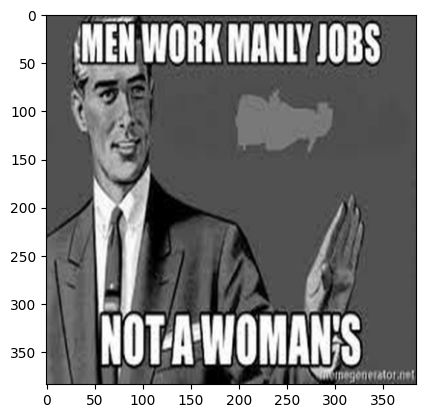


Sample: 8
Label: 0
Count vector: [array(['all', 'and', 'are', 'at', 'attention', 'avoid', 'but',
       'community', 'costs', 'do', 'fine', 'itself', 'maybe', 'me',
       'okay', 'say', 'should', 'system', 'the', 'thinking', 'to', 'want',
       'was', 'what', 'whore', 'works'], dtype='<U25')]
Bert token: ['i', 'was', 'thinking', 'maybe', 'i', 'should', 'register', 'to', 'im', '##db', '.', 'attention', 'whore', '.', 'okay', ',', 'the', 'system', 'itself', 'works', 'but', 'avoid', 'the', 'community', 'at', 'all', 'costs', '.', 'fine', ',', 'the', 'discussions', 'are', 'educational', 'and', 'constructive', '.', 'what', '?', 'what', 'do', 'want', 'me', 'to', 'say', '?', 'nothing', '##king']


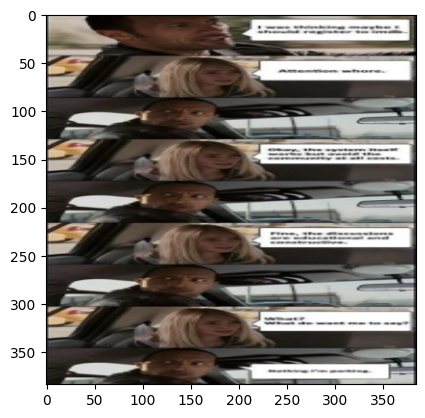


Sample: 9
Label: 1
Count vector: [array(['ass', 'girl', 'her', 'is', 'meme', 'on', 'only', 'place', 'slap',
       'the', 'to', 'woman'], dtype='<U25')]
Bert token: ['the', 'only', 'acceptable', 'place', 'to', 'slap', 'a', 'woman', 'is', 'on', 'her', 'ass', 'only', 'acceptable', 'place', 'to', 'slap', 'a', 'woman', 'is', 'on', 'her', 'ass', '-', 'girl', 'me', '##me']


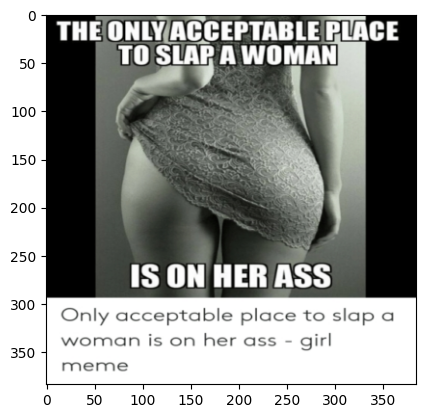


Sample: 10
Label: 0
Count vector: [array(['believe', 'can', 'girl', 'in', 'is', 'mum', 'photo', 'this'],
      dtype='<U25')]
Bert token: ['can', "'", 't', 'believe', 'this', 'girl', "'", 's', 'mum', 'is', 'posing', 'top', '##less', 'in', 'this', 'photo', '!', 'w', '##y']


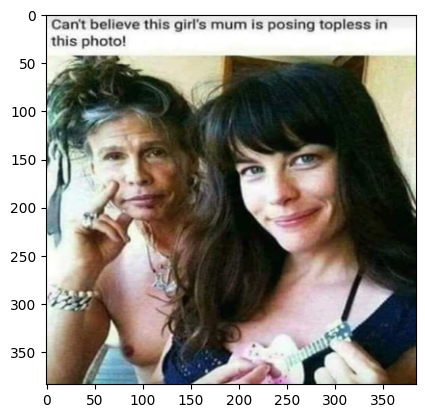


Sample: 11
Label: 1
Count vector: [array(['18', '19', 'animals', 'dance', 'pets', 'queen'], dtype='<U25')]
Bert token: ['0', ':', '18', '/', '2', ':', '19', 'freestyle', 't', '##werk', 'dance', 'queen', "'", 's', ':', ')', 'category', 'pets', '&', 'animals']


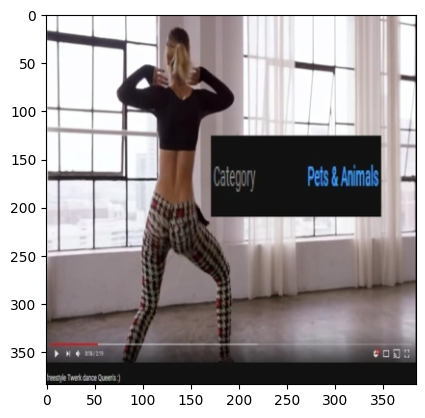


Sample: 12
Label: 1
Count vector: [array(['an', 'at', 'can', 'com', 'education', 'in', 'now', 'posted',
       'real', 'that', 'the', 'use', 'world', 'you'], dtype='<U25')]
Bert token: ['seton', 'hall', 'seton', 'hall', 'now', 'that', "'", 's', 'an', 'education', 'you', 'can', 'use', 'in', 'the', 'real', 'world', 'posted', 'at', 'the', '##chi', '##ve', '.', 'com']


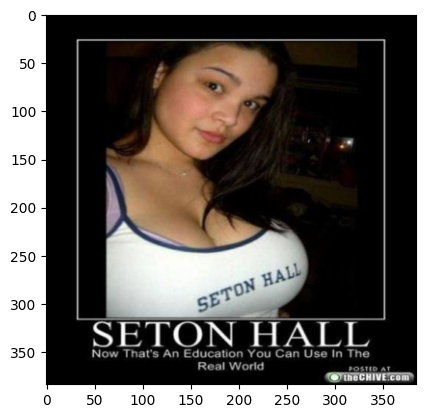


Sample: 13
Label: 1
Count vector: [array(['asked', 'com', 'could', 'cut', 'do', 'don', 'from', 'god',
       'handle', 'her', 'if', 'imgflip', 'll', 'my', 'no', 'off', 'oh',
       'she', 'tell', 'thank', 'that', 'the', 'thing', 'think', 'to',
       'when', 'wife'], dtype='<U25')]
Bert token: ['when', 'i', 'tell', 'my', 'wife', 'i', "'", 'll', 'cut', 'her', 'off', 'from', 'the', 'd', 'if', 'she', 'don', "'", 't', 'do', 'the', 'thing', 'i', 'asked', 'her', 'to', 'do', 'oh', 'no', ',', 'i', 'don', "'", 't', 'think', 'i', 'could', 'handle', 'that', 'im', '##gf', '##lip', '.', 'com', 'thank', 'god']


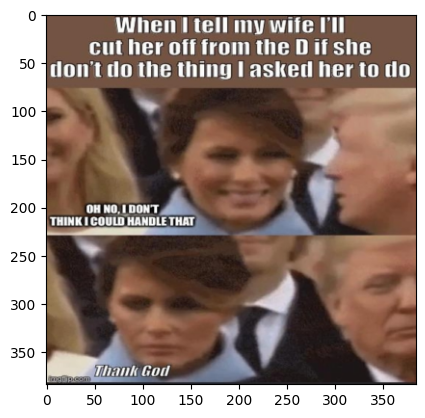


Sample: 14
Label: 1
Count vector: [array(['acting', 'bed', 'children', 'do', 'for', 'girlfriend', 'grown',
       'its', 'like', 'man', 'need', 'one', 'play', 're', 'start', 'to',
       'warzone', 'why', 'you'], dtype='<U25')]
Bert token: ['girlfriend', ':', 'why', 'do', 'you', 'need', 'to', 'play', 'war', '##zone', '!', '!', 'its', 'for', 'children', ',', 'you', "'", 're', 'a', 'grown', 'man', ',', 'start', 'acting', 'like', 'one', '.', '.', 'girlfriends', 'bed', ':']


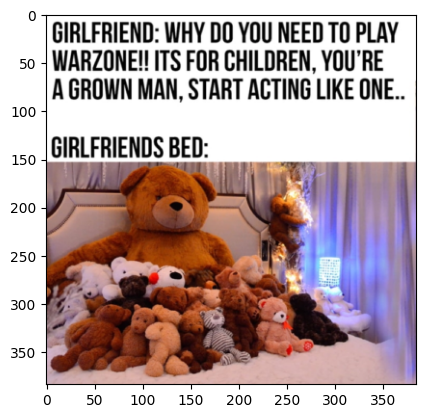


Sample: 15
Label: 1
Count vector: [array(['and', 'are', 'calls', 'day', 'equal', 'men', 'next', 'one', 'pig',
       'reaction', 'says', 'she', 'the', 'very', 'when', 'women', 'you',
       'your'], dtype='<U25')]
Bert token: ['your', 'reaction', 'when', 'she', 'calls', 'you', 'a', 'pig', 'one', 'day', 'and', 'says', 'men', 'and', 'women', 'are', 'equal', 'the', 'very', 'next', 'day']


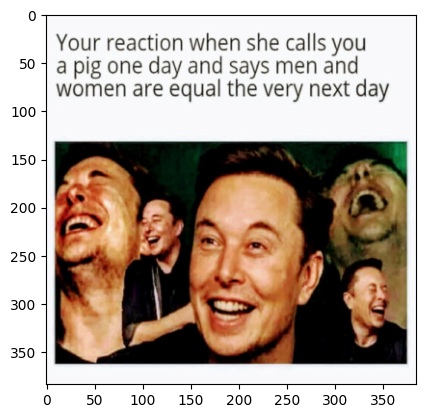


Sample: 16
Label: 1
Count vector: [array(['boobs', 'can', 'fake', 'if', 'memegenerator', 'net', 'or', 're',
       'real', 'see', 'them', 'they', 'touch'], dtype='<U25')]
Bert token: ['fake', 'boo', '##bs', '?', '!', '?', 'if', 'i', 'can', 'see', 'or', 'touch', 'them', ',', 'they', "'", 're', 'real', '!', '!', '!', 'me', '##me', '##gen', '##era', '##tor', '.', 'net']


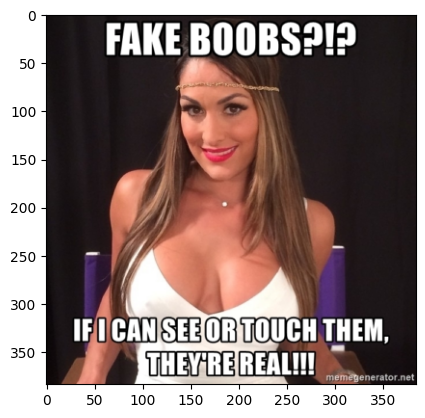


Sample: 17
Label: 1
Count vector: [array(['for', 'it', 'plastic', 'woman', 'years'], dtype='<U25')]
Bert token: ['woman', 'waters', 'plant', 'for', '2', 'years', ',', 'discovers', 'it', "'", 's', 'plastic', 'gr', '##ene', '##th', '##ump']


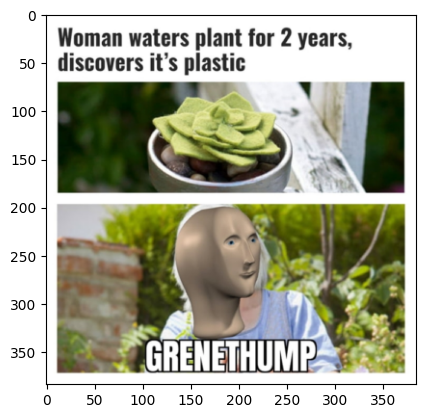


Sample: 18
Label: 0
Count vector: [array(['goal', 'new'], dtype='<U25')]
Bert token: ['a', 'new', 'goal', 'achieved', 'warn']


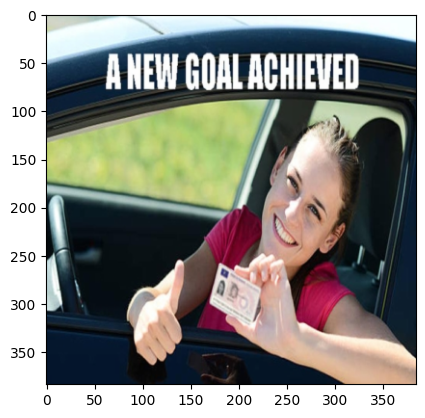


Sample: 19
Label: 0
Count vector: [array(['are', 'city', 'coronavirus', 'dolphins', 'in', 'meanwhile', 'of',
       'thanks', 'the', 'to', 'venice'], dtype='<U25')]
Bert token: ['thanks', 'to', 'corona', '##virus', ',', 'dolphins', 'are', 'returning', 'to', 'venice', '.', 'meanwhile', ',', 'in', 'the', 'sunken', 'city', 'of', 'r', "'", 'l', '##yeh', ':']


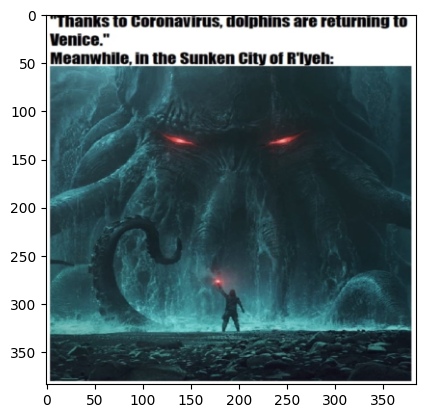


Sample: 20
Label: 0
Count vector: [array(['3rd', 'above', 'ber', 'bernie', 'black', 'bottom', 'calls',
       'first', 'gang', 'gives', 'good', 'kid', 'look', 'member', 'mom',
       'of', 'right', 'says', 'someone', 'sugar', 'support', 'woman',
       'you'], dtype='<U25')]
Bert token: ['mom', 'says', 'you', 'look', 'good', 'black', 'woman', 'calls', 'you', 'sugar', 'gang', 'member', 'calls', 'you', 'good', 'kid', 'someone', 'gives', 'you', 'financial', 'support', 'look', 'above', 'first', 'bernie', 'bottom', 'right', 'of', '3rd', 'bernie', 'be', '##r', 'bernie', 'bern', '##i', 'rn', '##ie', '1776', 'of', 'of']


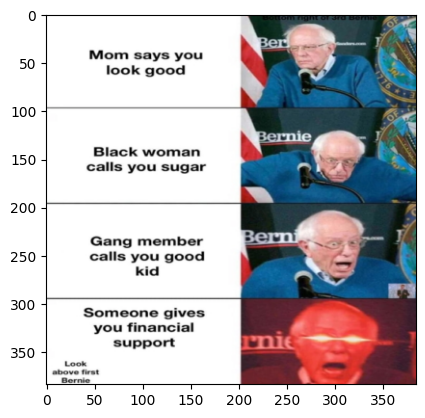


Sample: 21
Label: 1
Count vector: [array(['38', 'it', 'on', 'right', 'wanted', 'you'], dtype='<U25')]
Bert token: ['@', 'women', '##bri', '##nging', '##you', '##san', '##d', '##wich', '##es', '38', 'you', 'wanted', 'it', 'on', 'toast', ',', 'right', '?']


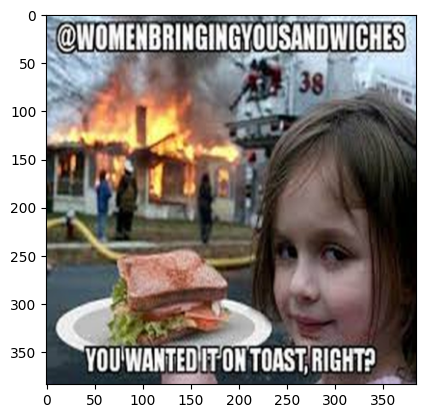


Sample: 22
Label: 1
Count vector: [array(['18', '40', 'and', 'as', 'feminist', 'out', 'son', 'spend',
       'still', 'straight', 'turns', 'when', 'years', 'you', 'your'],
      dtype='<U25')]
Bert token: ['when', 'you', 'spend', '18', 'years', 'as', 'a', 'feminist', 'intersection', '##al', 'tran', '##ny', 'and', 'your', 'son', 'still', 'turns', 'out', 'straight', '40', '%', 'i']


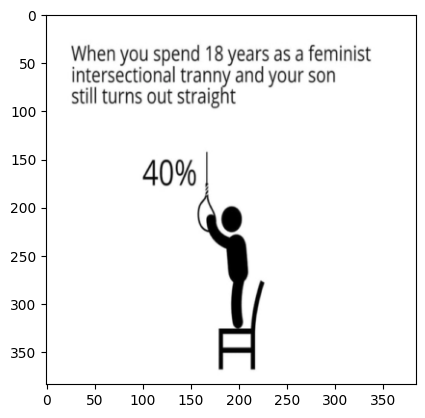


Sample: 23
Label: 0
Count vector: [array(['my', 'president', 'speech', 'those', 'trump', 'up', 'were',
       'your'], dtype='<U25')]
Bert token: ['nancy', 'pe', '##los', '##i', 'president', 'trump', 'those', 'were', 'my', 'ito', '##re', 'up', 'your', 'speech', 'imp', '##ea', '##chment', 'papers']


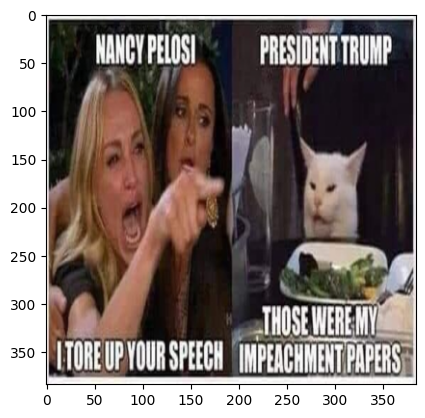


Sample: 24
Label: 1
Count vector: [array(['girlfriend', 'is', 'night', 'son', 'spending', 'the', 'your'],
      dtype='<U25')]
Bert token: ['son', 'is', 'your', 'girlfriend', 'spending', 'the', 'night', 'o', '##v', '.', '.', '.', 'r']


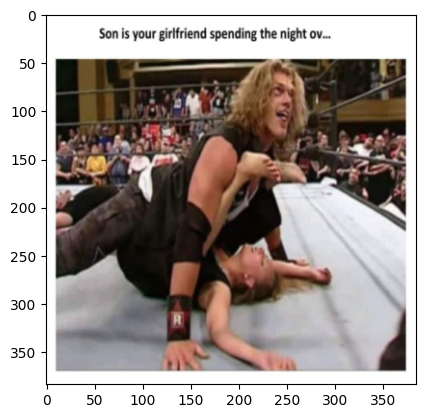


Sample: 25
Label: 0
Count vector: [array(['game', 'harry', 'lord', 'netflix', 'of', 'or', 'potter', 'the',
       'witch', 'witcher'], dtype='<U25')]
Bert token: ['im', '##e', 'netflix', 'the', 'witch', '##er', '-', 'harry', 'potter', 'or', 'game', 'of', 'throne', '##s', '?', 'im', '##e', '@', 'or', '##tad', 'netflix', '-', 'the', 'lord', 'of', 'the', 'rings', '.', 'witch']


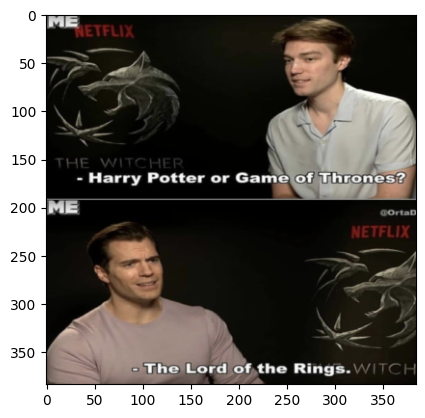


Sample: 26
Label: 1
Count vector: [array(['10', 'because', 'com', 'not', 'quickmeme', 'republican', 'she',
       'stupid', 'woman'], dtype='<U25')]
Bert token: ['she', "'", 's', 'not', 'stupid', 'because', 'she', "'", 's', 'a', 'republican', '10', 'she', "'", 's', 'stupid', 'because', 'she', "'", 's', 'a', 'woman', 'quick', '##me', '##me', '.', 'com']


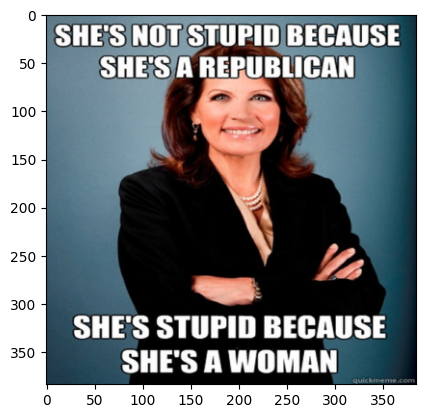


Sample: 27
Label: 1
Count vector: [array(['could', 'expectation', 'fuck', 'get', 'how', 'it', 'reality',
       'the', 'this', 'vs', 'wrong', 'you'], dtype='<U25')]
Bert token: ['expectation', 'vs', 'bu', '##elle', 'des', 'fort', '##ific', '##ati', '@', 'suit', '##ably', '##bor', '##ed', 'reality', 'how', 'the', 'fuck', 'could', 'you', 'get', 'it', 'this', 'wrong', '?']


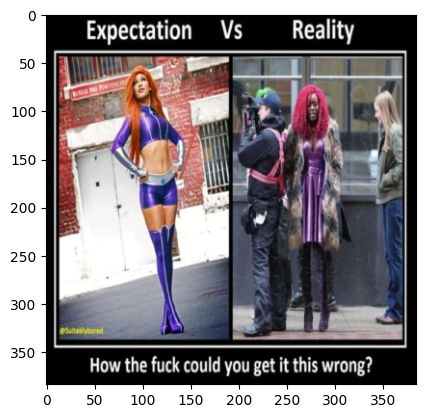


Sample: 28
Label: 0
Count vector: [array(['52', 'at', 'can', 'girlfriend', 'have', 'home', 'mom', 'no', 'we'],
      dtype='<U25')]
Bert token: ['mom', ',', 'can', 'i', 'have', 'a', 'girlfriend', '?', 'girlfriend', 'at', 'home', '.', 'no', ',', 'we', 'have', 'girlfriend', 'at', 'home', '.', '52']


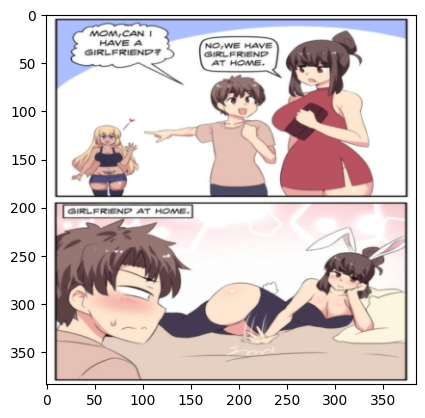


Sample: 29
Label: 1
Count vector: [array(['cleavage', 'has', 'power', 'wonderful'], dtype='<U25')]
Bert token: ['cleavage', 'has', 'a', 'wonderful', 'hypnotic', 'power']


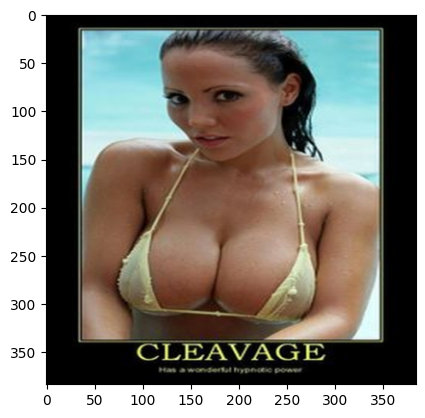


Sample: 30
Label: 0
Count vector: [array(['11', '2020', '28', 'after', 'begins', 'bites', 'but', 'died',
       'elderly', 'friday', 'her', 'in', 'it', 'late', 'man', 'march',
       'neck', 'nude', 'on', 'pm', 'quarantined', 'runs', 'said',
       'saturday', 'shame', 'so', 'the', 'they', 'to', 'updated', 'was',
       'with', 'without', 'woman'], dtype='<U25')]
Bert token: ['man', 'runs', 'nude', "'", 'qu', '##aran', '##tine', '##d', "'", 'in', 'tamil', 'nadu', ',', 'fatally', 'bites', 'elderly', 'woman', 'the', 'woman', 'with', 'injuries', 'in', 'her', 'neck', 'was', 'hospital', '##ised', 'late', 'friday', 'after', 'the', 'incident', 'but', 'died', 'on', 'saturday', 'without', 'responding', 'to', 'treatment', ',', 'they', 'said', '.', 'updated', 'on', ':', 'march', '28', ',', '2020', ',', '6', ':', '11', 'pm', 'ist', 'so', 'it', 'begins', 'shame', '.']


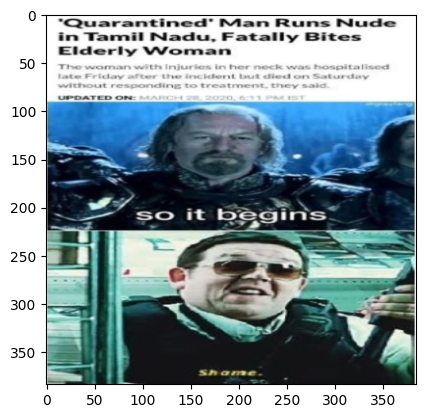


Sample: 31
Label: 1
Count vector: [array(['every', 'female', 'takes'], dtype='<U25')]
Bert token: ['takes', 'self', '##ie', ':', 'every', 'female', ':']


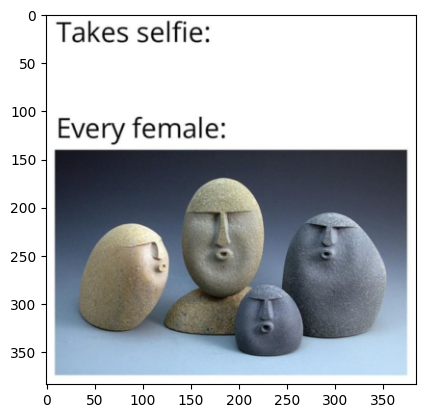


Sample: 32
Label: 0
Count vector: [array(['and', 'are', 'cat', 'cause', 'ginger', 'in', 'kids', 'loved',
       'my', 'put', 'that', 'their', 'they', 'upset', 'wife'],
      dtype='<U25')]
Bert token: ['my', 'wife', 'and', 'kids', 'are', 'upset', 'cause', 'i', 'put', 'ginger', 'in', 'their', 'curry', 'www', '##w', '##w', '##w', '##w', '##w', '##w', 's', 'they', 'loved', 'that', 'cat']


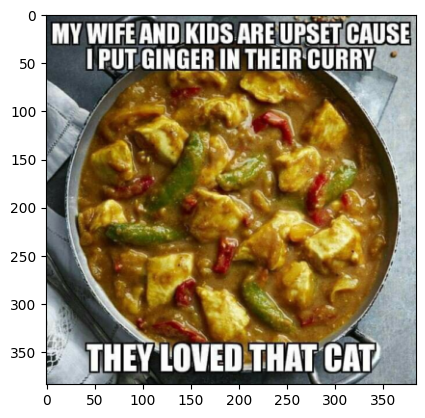


Sample: 33
Label: 1
Count vector: [array(['are', 'boob', 'can', 'challenge', 'pass', 'real', 'the', 'under',
       'woman', 'you'], dtype='<U25')]
Bert token: ['are', 'you', 'a', 'real', 'woman', '?', '?', 'can', 'you', 'pass', 'the', 'pen', 'under', 'boo', '##b', 'challenge', '?', '?']


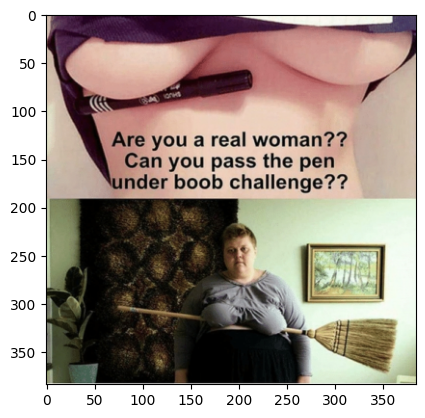


Sample: 34
Label: 0
Count vector: [array(['everything', 'is', 'ne', 'without', 'yo'], dtype='<U25')]
Bert token: ['without', 'objective', 'morality', ',', 'everything', 'is', 'per', '##missible', '.', 'ne', 'st', '##am', '##ben', 'nut', '##ella', 'yo']


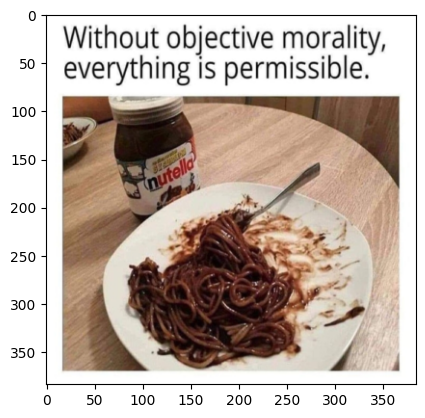


Sample: 35
Label: 0
Count vector: [array(['90', 'com', 'cooking', 'for', 'imgflip', 'in', 'minutes', 'sun',
       'the'], dtype='<U25')]
Bert token: ['i', '##gat', '##o', 'cooking', 'instructions', ':', 'ba', '##ke', '2', 'pie', '##s', 'in', 'the', 'sun', 'for', '90', 'minutes', 'im', '##gf', '##lip', '.', 'com', 'pre', '##ll']


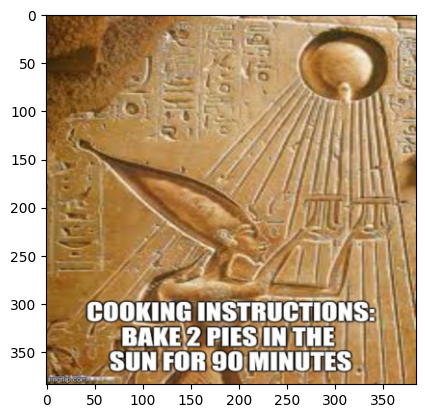


Sample: 36
Label: 1
Count vector: [array(['dry', 'her', 'like', 'was'], dtype='<U25')]
Bert token: ['her', 'baked', 'mac', '##aro', '##ni', 'was', 'dry', 'like', 'her', 'elbows']


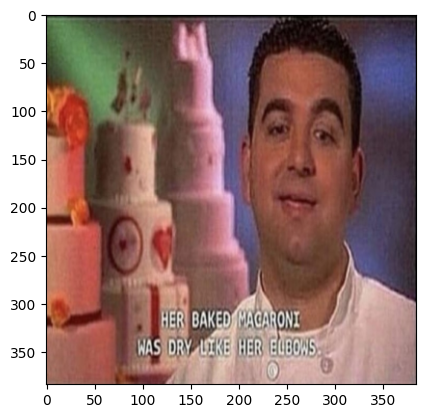


Sample: 37
Label: 0
Count vector: [array(['about', 'but', 'com', 'did', 'die', 'driving', 'my', 'people',
       'quickmeme', 'talk', 'when', 'you'], dtype='<U25')]
Bert token: ['when', 'people', 'talk', 'about', 'my', 'driving', '.', '.', '.', 'but', 'did', 'you', 'die', '?', 'quick', '##me', '##me', '.', 'com']


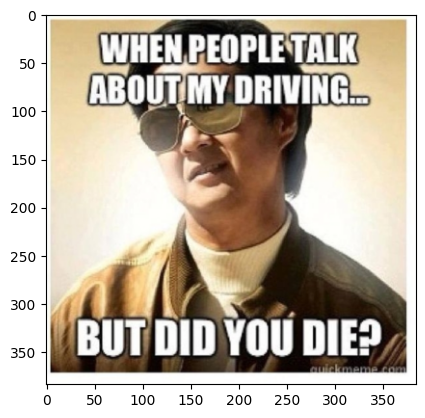


Sample: 38
Label: 1
Count vector: [array(['com', 'food', 'hot', 'imgflip', 'isn', 'mom', 'that', 'the'],
      dtype='<U25')]
Bert token: ['im', '##gf', '##lip', '.', 'com', 'mom', ':', 'the', 'food', 'isn', "'", 't', 'that', 'hot', 'the', 'food', ':']


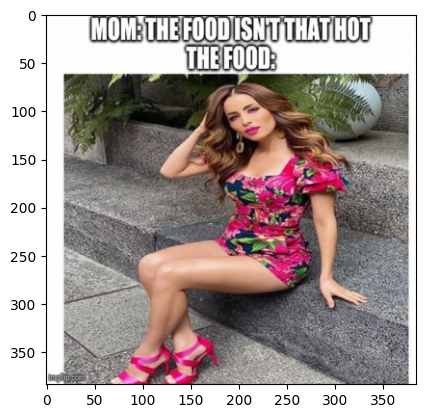


Sample: 39
Label: 0
Count vector: [array(['after', 'clean', 'dog', 'my', 'outside', 'playing', 're'],
      dtype='<U25')]
Bert token: ['my', 'dog', 'after', 'playing', 'outside', 're', 'my', 'vehicle', "'", 's', 'clean', 'up', '##hol', '##ster', '##y']


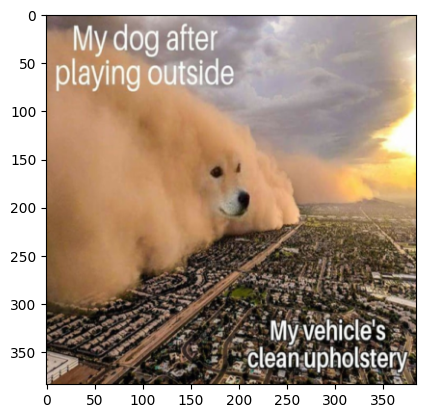

In [39]:
visual_batch(val_sup_img_batch, val_sup_text_batch, val_sup_label_batch, im_transforms=im_transforms, txt_transforms=txt_transforms)

In [53]:
for epoch in range(5):
    for i, (supbatch, unsupbatch) in tqdm(enumerate(zip(train_supervised_loader, train_unsupervised_loader)), total=min(len(train_supervised_loader), len(train_unsupervised_loader))):
        pass
#     print(i)
#     if i>1000:
#         break

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 124/124 [00:12<00:00,  9.70it/s]
